In [1]:
import numpy as np
from scipy.ndimage.interpolation import rotate

from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection

from sklearn import manifold
from sklearn.metrics import euclidean_distances
from sklearn.decomposition import PCA

import os
import re
import sqlite3
import json
import pandas as pd
from helpers import *
from itertools import combinations, combinations_with_replacement

from IPython.core.display import HTML
%matplotlib inline

HTML("<style>.container { width:90% !important; }</style>")

In [ ]:
map(sum,[1,3,4,5])

In [2]:
os.chdir('..')

In [3]:
db = 'data/congress_networks.db'
con = sqlite3.connect(db)

congresscon = sqlite3.connect('data/congress.db')

senators = pd.read_sql_query('select * from senators',congresscon)

senators.set_index('id',inplace=True)

In [4]:
senators.head(5)

,first_name,last_name,state,district,party,birthday,birth_year,birth_quarter,birth_month,url,twitter,facebook,facebook_id,youtube,youtube_id,opensecrets_id,wikipedia_id,washington_post_id
id,,,,,,,,,,,,,,,,,,
401222,Richard,Bassett,DE,None,Anti-Administration,1745-04-02,1745,6982,20944,None,None,None,None,None,None,None,None,None
401521,Theodorick,Bland,VA,9.0,None,1742-03-21,1742,6969,20907,None,None,None,None,None,None,None,None,None
402032,Aedanus,Burke,SC,2.0,None,1743-06-16,1743,6974,20922,None,None,None,None,None,None,None,Aedanus Burke,None
402334,Daniel,Carroll,MD,6.0,None,1730-07-22,1730,6923,20767,None,None,None,None,None,None,None,Daniel Carroll,None
402671,George,Clymer,PA,-1.0,None,1739-03-16,1739,6957,20871,None,None,None,None,None,None,None,George Clymer,None


In [282]:
agreement_inverses = {'agreement':lambda x: 1-x,'affinity':lambda x: 1.0/x}
#identity_distances = {'agreement':}

def get_nodes(con,time_var,location,time=None,start=None,end=None):
    if start is None:
        command = """select * from nodes_{} where location='{}' and time={}""".format(time_var,location,time)
    else:
        command = """select * from nodes_{} where location='{}' and time>={} and time<={}""".format(time_var,location,start,end)
    nodes = pd.read_sql_query(command,con)
    nodes.set_index('id',inplace=True,drop=False)
    
    return nodes


def get_edges(con,time_var,time,location,start=None,end=None):
    if not start:
        command = """select * from affinities_{} where location='{}' and time={}""".format(time_var,location,time)
    else:
        command = """select * from afinities_{} where location='{}' and time>={} and time<={}""".format(time_var,location,start,end)
    edges = pd.read_sql_query(command,con)
    edges.set_index(['id1','id2'],inplace=True,drop=False)
    return edges


def get_distances(con,agreement_metric,time_var,location,time=None,transform=None):
    command = """
    select id1, id2, {} from affinities_{} where location='{}' and time={}""".format(agreement_metric,time_var,location,time)
    edges = pd.read_sql_query(command,con)
    if edges.shape[0] == 0:
        print("no samples for {} {}".format(time_var,time))
        return None
    #edges.index = edges.index.values+1
    #edges.loc[0,:] = [edges['id1'][1],edges['id1'][1],np.nan]
    edges.set_index(['id1','id2'],inplace=True)
    edges = edges.loc[:,agreement_metric]
    edges2 = edges.copy()
    edges2.index = pd.MultiIndex.from_tuples([tuple(reversed(pair)) for pair in edges.index],names=('id1','id2'))
    edges = pd.concat((edges,edges2))
    
    sims = edges.unstack('id2')
    sims.sort_index(axis=0,inplace=True)
    sims.sort_index(axis=1,inplace=True)
    
    # sims become distances with the inverse function for embedding
    sims = agreement_inverses[agreement_metric](sims)
    sims.fillna(0,inplace=True)
    
    if transform:
        return transform(sims)
    else:
        return sims


def compute_embedding(sims, senators=senators, last_ids=None,last_embedding=None,last_centers=None):
    parties = senators.party[sims.index]
    parties = parties.apply(normalize_party)
    
    mds = manifold.MDS(n_components=2, max_iter=50000, eps=1e-9, random_state=seed,
                       dissimilarity="precomputed", n_jobs=-2,metric=True)
    
    if last_embedding is None:
        embedding = mds.fit(sims.values).embedding_
    else:
        init = np.zeros((sims.shape[0],2))
        locs = sims.index.get_indexer(last_ids)
        keeplocs = np.where(locs >= 0)
        locs = locs[keeplocs]
        init[locs,:] = last_embedding[keeplocs,:]
        newlocs = np.ones(init.shape[0],dtype=bool)
        newlocs[locs] = False
        dem_locs = parties.values=='democrat'
        rep_locs = parties.values=='republican'
        indices = np.logical_and(rep_locs,newlocs)
        init[indices,:] = np.random.randn(indices.sum(),2)/5.0 #+ last_centers[0]
        indices = np.logical_and(dem_locs,newlocs)
        init[indices,:] = np.random.randn(indices.sum(),2)/5.0 #+ last_centers[1]
        
        embedding = mds.fit(sims.values,init = init).embedding_
            
    
    center = embedding.mean(axis=0)
    embedding = embedding - center
    #plt.plot(*center,'go')
    
    # now everything might be a little off center if we want the party means to line up on a line
    # through the origin; let's fix that
    rep_center = embedding[parties.values=='republican',:].mean(axis=0)
    dem_center = embedding[parties.values=='democrat',:].mean(axis=0)
    #plt.plot(*rep_center,'go')
    #plt.plot(*dem_center,'go')
    
    # minimize the distance from the origin along a line joining these
    #norm1 = np.sum(rep_center**2)
    #norm2 = np.sum(dem_center**2)
    #dot = np.sum(rep_center*dem_center)
    #delta = (1-norm2/dot)/(norm2/norm1-1)
    #delta = (dot + norm2)/(norm1 + norm2 + 2.0*dot)
    #center = delta*rep_center + (1-delta)*dem_center
    #print(delta)
    #print(center)
    #embedding = embedding - center
    #rep_center = rep_center - center
    #dem_center = dem_center - center
        
    # now rotate to put parties in thier left-right orientation
    norm1 = np.sqrt(np.sum(rep_center**2))
    cos = rep_center[0]/norm1
    sin = rep_center[1]/norm1
    rot = np.array([[cos,-1.0*sin],[sin,cos]])
    embedding = np.apply_along_axis(lambda row: np.dot(row,rot),1,embedding)
    rep_center = np.dot(rep_center,rot)
    dem_center = np.dot(dem_center,rot)
    
    return embedding, sims.index, (rep_center, dem_center)
    
    
def plot_network(sims,embedding,threshold=0.1,senators=senators,xlim=(-0.6,0.6),ylim=(-0.3,0.3),location=None,month=None,year=None):
    parties = senators.party[sims.index]
    parties = parties.apply(normalize_party)
    #print(parties[0:10])
    colors = parties.apply(lambda party: party_colors.get(party,'y'))
    
    edges = [[embedding[i, :], embedding[j, :], sims.iloc[i,j],(sims.index[i],sims.columns[j])] for i,j in combinations(np.arange(sims.shape[0]),2) if sims.iloc[i,j] < threshold]
    #print("{} edges".format(len(edges)))
    
    #sizes = [10*sum([edge[2] for edge in edges if name in edge[3]]) for name in sims.index.values]
    sizes = 200*np.square(1-sims).apply(np.mean,axis=1)
    
    fig = plt.figure(1)
    ax = plt.axes()
    ax.set_xlim(xlim[0],xlim[1])
    ax.set_ylim(ylim[0],ylim[1])
    plt.text(0.9*xlim[0]+0.1*xlim[1],0.9*ylim[1]+0.1*ylim[0],"{}, {}/{}".format(location,month,year), fontsize=18)
    
    if(len(edges) > 0):
        linewidths = [edge[2] for edge in edges]
        edges = LineCollection([edge[0:2] for edge in edges],cmap='Purples')
        edges.set_linewidths(linewidths)
        ax.add_collection(edges)
    
    ax.scatter(embedding[:,0],embedding[:,1],s=sizes,c = colors,marker='o')

    
def upload_embedding(con,ids,embedding,time_var,time,location):
    nodes = get_nodes(con=con,time_var=time_var,time=time,location=location)
    nodes.loc[ids,['x','y']] = embedding
    
    command = "insert or replace into nodes_{} values "
    command = command.format(time_var) + "{}"
    
    # executemany() should work in place of a loop here but it didn't
    for i in range(nodes.shape[0]):
        con.execute(command.format(tuple(nodes.iloc[i,:])))
        
    con.commit()
    
    # test
    #nodes = con.execute("select * from nodes_{} where time={}".format(time_var,time)).fetchall()
    #print("This is what is in the db after commit:")
    #print(nodes)
    


punct = re.compile(r"[-\'\. ]")
    
def normalize_party(party,punct=punct):
    return re.sub(punct,'',party).lower()
    

dem_color = 'blue'
rep_color = 'red'
party_colors = {'democrat':dem_color,'democrat': dem_color,'republican':rep_color}

seed = np.random.RandomState(seed=3)

In [283]:
def write_json(con,output_dir,time_var,start,end,location,senators=senators):
    all_nodes = {}
    all_edges = {}
    for time in range(start,end+1):
        nodes = get_nodes(con=con,time_var=time_var,time=time,location=location)
        nodes.drop('time',axis=1,inplace=True)
        
        edges = get_edges(con=con,time_var=time_var,time=time,location=location)
        edges.drop('time',axis=1,inplace=True)
        all_nodes[time] = [tuple(nodes.loc[i,:]) for i in nodes.index]
        all_edges[time] = [tuple(edges.loc[i,:]) for i in edges.index]
        
    node_keys = dict(zip(nodes.columns,range(len(nodes.columns))))
    edge_keys = dict(zip(nodes.columns,range(len(nodes.columns))))
    
    periods = {'year':1,'quarter':4,'month':12}
    period = periods[time_var]
    # surely all politicians are between 20 and 110 years old
    politicians = senators[senators['birth_'+time_var] >= start - period*110]
    politicians = politicians[politicians['birth_'+time_var] <= end - period*20]
    
    #politician_keys = dict(zip(politicians.columns,range(len(politicians.columns))))
    politicians.to_fjson(os.path.join(output_dir,'politicians.json'),orient='index')
    
    with open(os.path.join(output_dir,'node_keys.json'),'w') as outfile:
        json.dump(node_keys,outfile)
    with open(os.path.join(output_dir,'edge_keys.json'),'w') as outfile:
        json.dump(edge_keys,outfile)
    
    with open(os.path.join(output_dir,'nodes.json'),'w') as outfile:
        json.dump(all_nodes,outfile)
    with open(os.path.join(output_dir,'edges.json'),'w') as outfile:
        json.dump(all_edges,outfile)


In [284]:
# This computes embeddings for each time slice in a sequence, with dependency between them -
# the prior embedding is used as a seed for the next embedding where the politician id's overlap
def plot_embed_upload(con,time_var,start,end,location,agreement_metric='agreement',threshold=0.2,xlim=None,ylim=None,savefig=False,savedir=None,upload=False):
    xy=None

    for time in np.arange(start,end+1):
        sims = get_distances(con=con,agreement_metric=agreement_metric,time_var=time_var,time=time,location=location,transform=None)
        if sims is None:
            continue
        
        if xy is not None:
            xy, ids, centers = compute_embedding(sims=sims,last_ids=ids,last_embedding=xy,last_centers=centers)
        else:
            xy, ids, centers = compute_embedding(sims=sims)
        
        if time_var == 'month':
            year = time//12
            month = time%12
            if month == 0:
                month = 12
                year -= 1
        elif time_var == 'quarter':
            year = time//4
            quarter = (time%4)
            if quarter == 0:
                quarter = 4
                year -= 1
            month = quarter * 3
        elif time_var == 'year':
            year = time
            month = ""
        
        if xlim is not None and ylim is not None:
            plot_network(sims,xy,threshold=threshold,xlim=xlim,ylim=ylim,location=location,month=month,year=year)
            plt.axis('off')
        else:
            plot_network(sims,xy,threshold=threshold,location=location,month=month,year=year)
        
        if upload:
            upload_embedding(con,ids=ids,embedding=xy,time_var=time_var,time=time,location=location)
            
        # test
        #nodes = get_nodes(con,time_var,location,time)
        #print(nodes)
        
        if savefig:
            plt.savefig(os.path.join(savedir,'{}_{}_{}.png'.format(location,time_var,time)))
            
        plt.close()


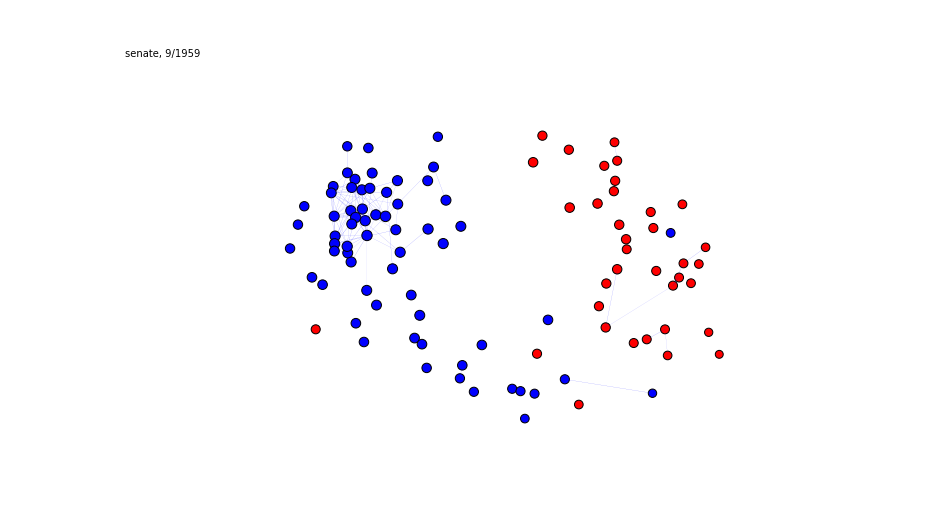

/home/matt/anaconda3/lib/python3.5/site-packages/sklearn/manifold/mds.py:238: UserWarning: Explicit initial positions passed: performing only one init of the MDS instead of 4
  % n_init)


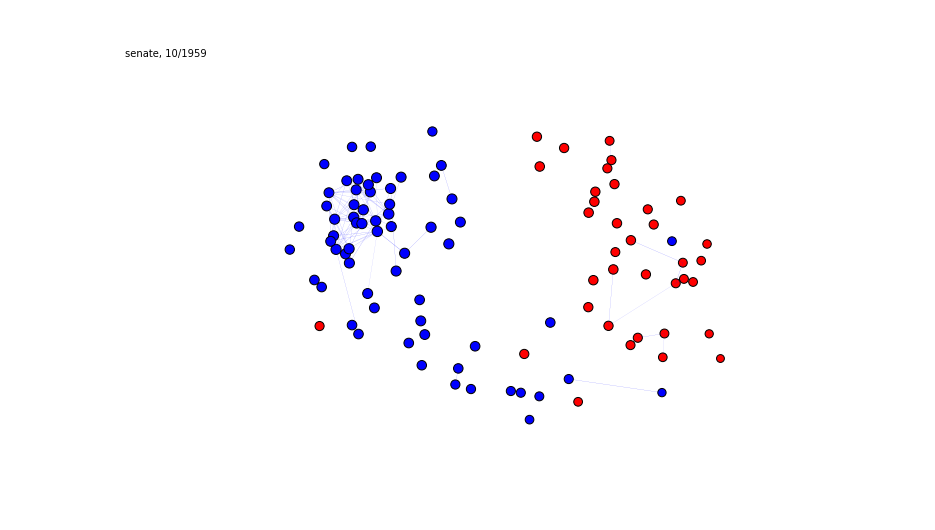

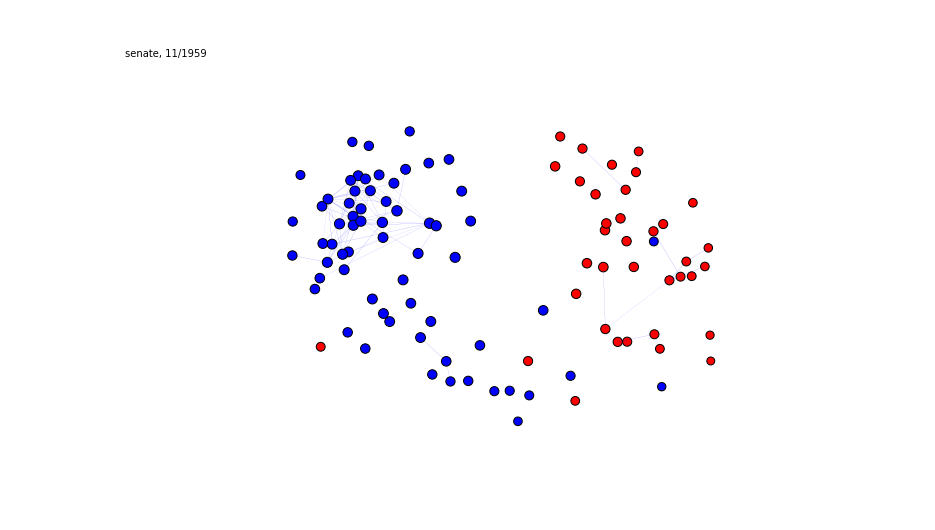

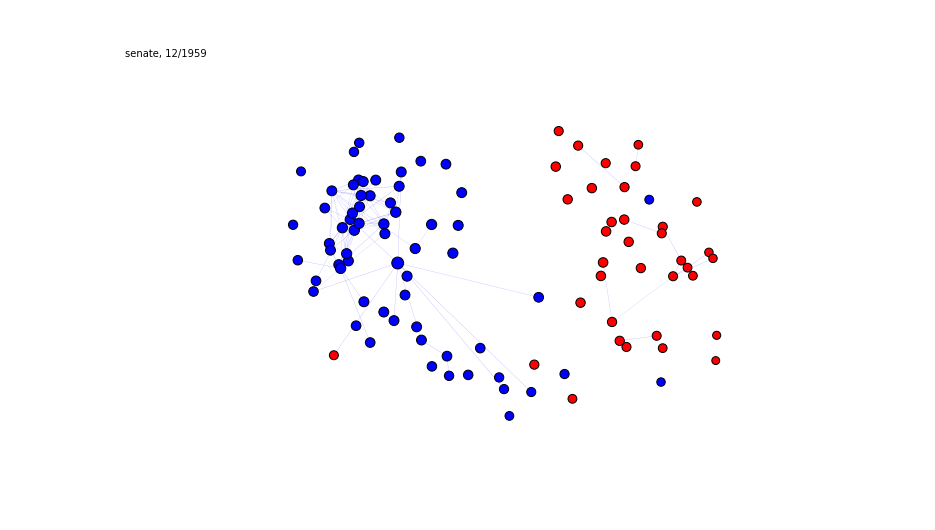

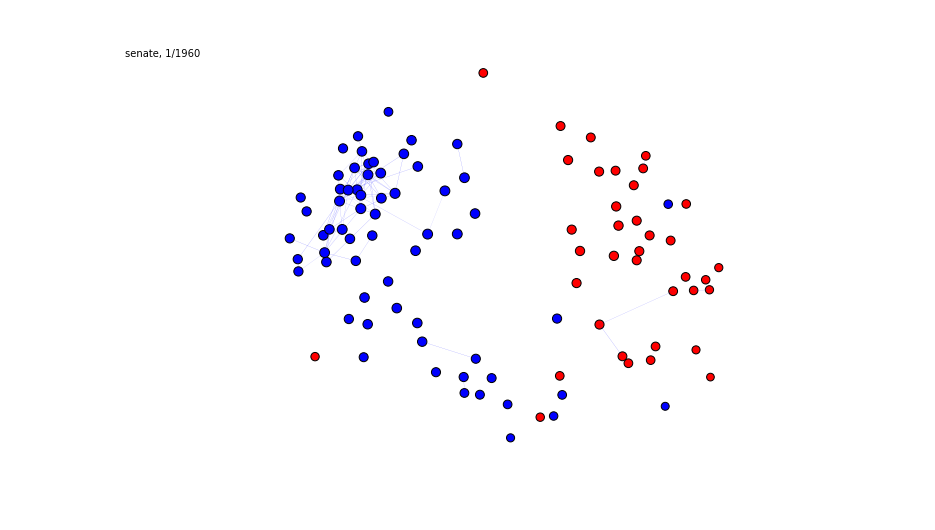

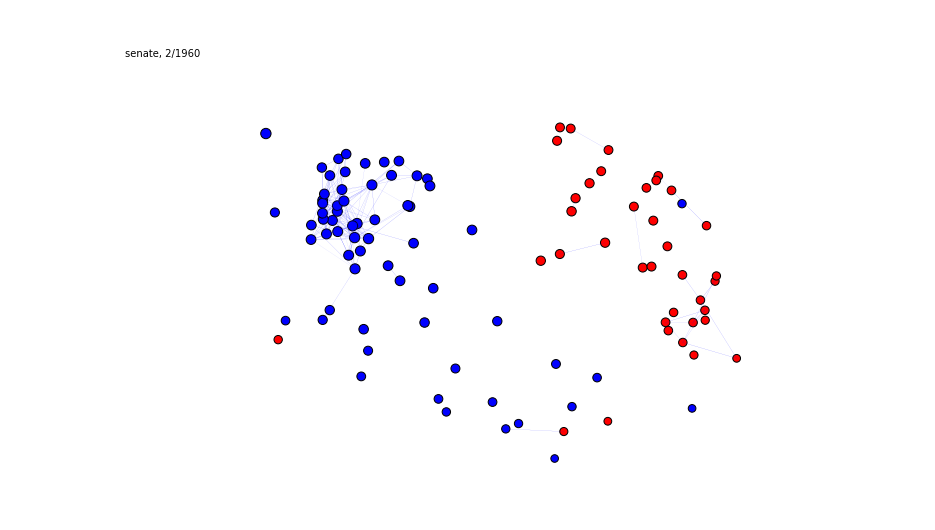

...

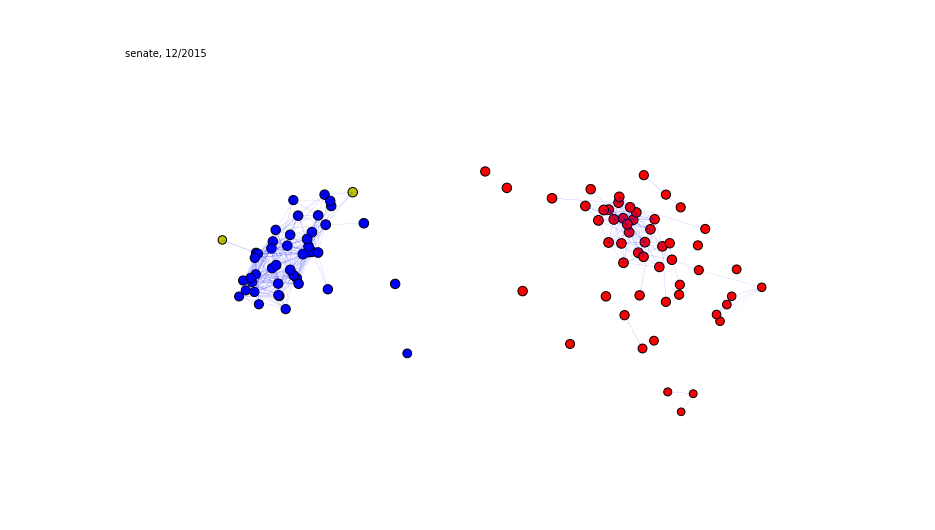

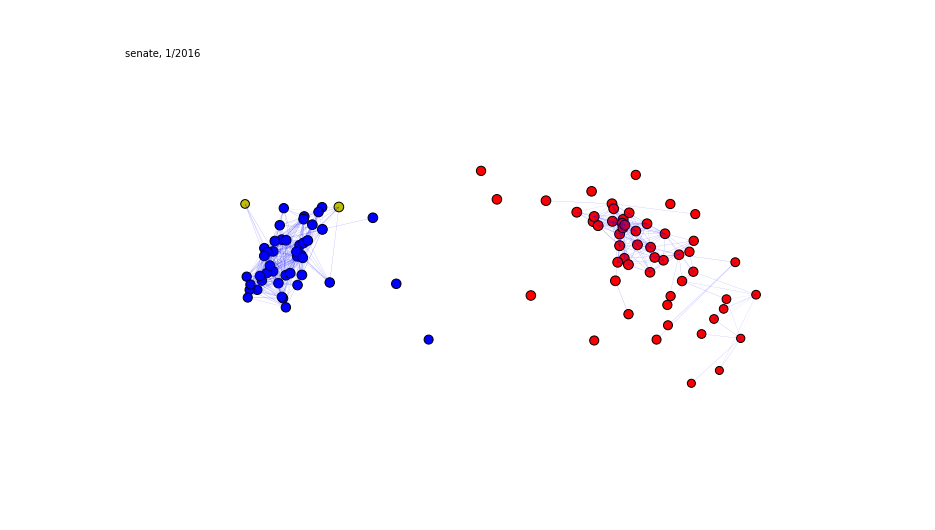

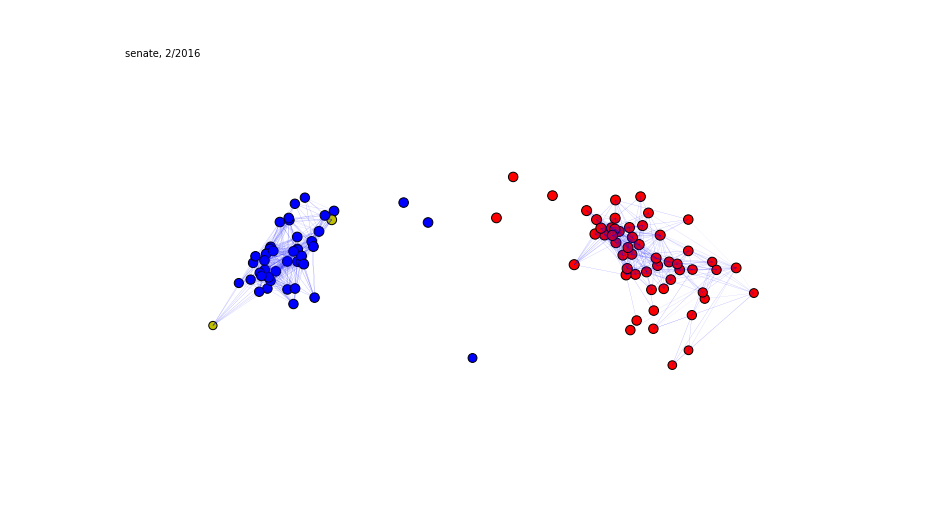

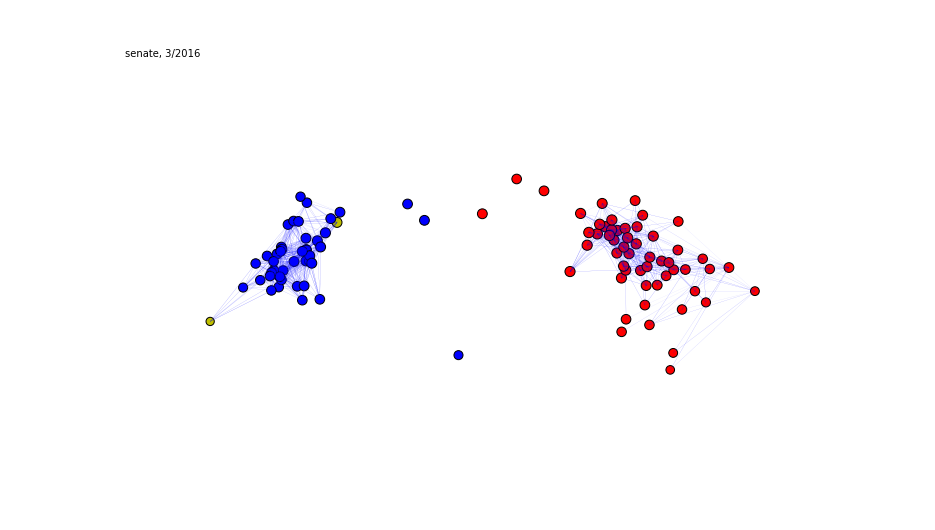

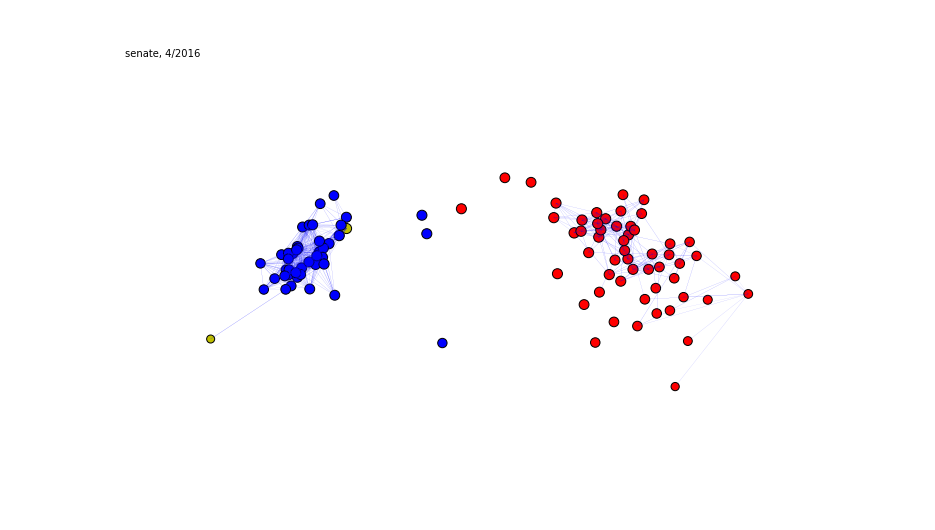

In [281]:
start = 1959*12+9
end = 2016*12+4
#time = 23998
time_var = 'month'
agreement_metric = 'agreement'
location='senate'
plt.rcParams['figure.figsize'] = 16,9
#con.close()
con = sqlite3.connect('data/congress_networks.db')

embed_plot_and_upload(con=con,time_var=time_var,start=start,end=end,location=location,agreement_metric=agreement_metric,
                      threshold=0.1,xlim=(-0.75,0.75),ylim=(-0.5,0.5),
                      upload=True,savefig=True,savedir='plots')

In [12]:
cong = sqlite3.connect('congress.db')

In [26]:
con.execute("select * from nodes_year where time=2012").fetchall()[0:5]

[('senate', 2012, '300001', 88, 23.0, 15.0, None, None),
 ('senate', 2012, '300002', 72, 10.0, 21.0, None, None),
 ('senate', 2012, '300005', 71, 34.0, 50.0, None, None),
 ('senate', 2012, '300009', 69, 30.0, 47.0, None, None),
 ('senate', 2012, '300011', 72, 20.0, 13.0, None, None)]

In [823]:
write_json(con=con,output_dir='json',time_var='year',start=2012,end=2015,location='senate')

id
300001    None
300002    None
300005    None
300009    None
300011    None
300018    None
300019    None
300021    None
300023    None
300025    None
300026    None
300027    None
300030    None
300038    None
300041    None
300043    None
300047    None
300048    None
300051    None
300052    None
300054    None
300055    None
300056    None
300058    None
300060    None
300061    None
300062    None
300063    None
300064    None
300065    None
          ... 
412218    None
412223    None
412242    None
412243    None
412244    None
412246    None
412247    None
412248    None
412249    None
412251    None
412320    None
412321    None
412322    None
412323    None
412324    None
412325    None
412326    None
412330    None
412378    None
412384    None
412390    None
412391    None
412490    None
412491    None
412492    None
412493    None
412494    None
412495    None
412496    None
412507    None
Name: x, dtype: object
id
300001    None
300002    None
300005    None
300009    N